In [1]:
import os
import tarfile
from pathlib import Path
import cv2
import json
import numpy as np
import matplotlib.pyplot as plt
import torch
from torch.utils.data import Dataset, DataLoader
import torchvision
from torchvision.models.detection import maskrcnn_resnet50_fpn
from tqdm import tqdm
import skimage.io as sio
import random
from torchvision.ops import masks_to_boxes
from google.colab import drive
import matplotlib.patches as patches

In [3]:
#file path in google drive
drive.mount('/content/drive')
drive_root = "/content/drive/MyDrive"
from utils import encode_mask, decode_maskobj

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
#extract dataset
extract_path = os.path.join(drive_root, "nycu-hw3-data")

if not os.path.exists(extract_path):
    dataset_path = os.path.join(drive_root, "hw3-data-release.tar.gz")
    os.makedirs(extract_path, exist_ok=True)
    with tarfile.open(dataset_path, "r:gz") as tar:
        tar.extractall(path=drive_root)  # On extrait directement dans drive_root
    print("Extraction done.")
else:
    print("Dataset already done.")


Dataset already done.


Folder selected : e18e1a1f-f4a8-44ea-8380-9db3310fbe47


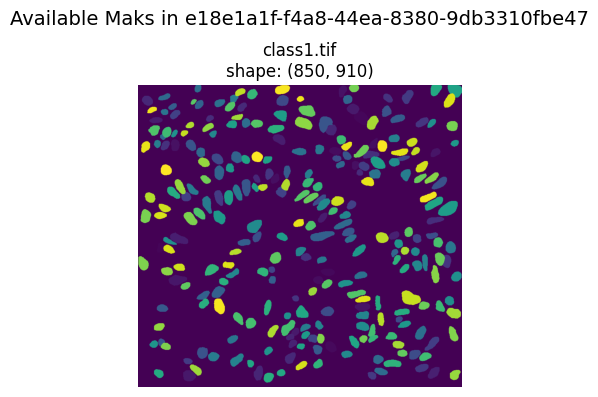

In [4]:
# dataset folder
train_dir = "/content/drive/MyDrive/hw3-data-release/train"


# ramdom choose folder
subfolders = [f for f in os.listdir(train_dir) if os.path.isdir(os.path.join(train_dir, f))]
sample_folder = random.choice(subfolders)
sample_path = os.path.join(train_dir, sample_folder)

print(f"Folder selected : {sample_folder}")

# get mask
mask_files = sorted([f for f in os.listdir(sample_path) if f.startswith("class") and f.endswith(".tif")])

if not mask_files:
    print("No mask found in this folder.")
else:
    # plot mask
    fig, axs = plt.subplots(1, len(mask_files), figsize=(4 * len(mask_files), 4))

    if len(mask_files) == 1:
        axs = [axs]

    for i, mask_file in enumerate(mask_files):
        mask_path = os.path.join(sample_path, mask_file)
        mask = cv2.imread(mask_path,cv2.IMREAD_UNCHANGED)

        axs[i].imshow(mask, cmap='viridis' if mask.ndim == 2 else None)
        axs[i].set_title(f"{mask_file}\nshape: {mask.shape}")
        axs[i].axis("off")

    plt.suptitle(f"Available Maks in {sample_folder}", fontsize=14)
    plt.tight_layout()
    plt.show()

In [5]:
class CustomInstanceDataset(Dataset):
    def __init__(self, root_dir, transforms=None):
        self.root_dir = Path(root_dir)
        self.sample_dirs = sorted([p for p in self.root_dir.iterdir() if p.is_dir()])
        self.transforms = transforms

    def __len__(self):
        return len(self.sample_dirs)

    def __getitem__(self, idx):
        folder_path = self.sample_dirs[idx]

        #load image
        image_path = folder_path  / 'image.tif'
        image = cv2.imread(str(image_path))
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        H, W, _ = image.shape
        masks = []
        labels = []

        # Load instance mask by class
        for class_id in range(1, 5):
            mask_path = folder_path / f'class{class_id}.tif'
            if mask_path.exists():
                mask = sio.imread(str(mask_path))
                for inst_id in np.unique(mask):
                    if inst_id == 0:
                        continue
                    binary_mask = (mask == inst_id).astype(np.uint8)
                    masks.append(binary_mask)
                    labels.append(class_id)

        # Fallback if no mask is found
        if not masks:
            masks = [np.zeros((H, W), dtype=np.uint8)]
            labels = [1]

        # Conversion to tensors
        labels = torch.tensor(labels, dtype=torch.int64)
        masks = torch.stack([torch.from_numpy(m) for m in masks], dim=0).to(torch.uint8)

        # Create bounding boxes from masks
        boxes = []
        for mask in masks:
            pos = np.where(mask)
            xmin = np.min(pos[1])
            xmax = np.max(pos[1])
            ymin = np.min(pos[0])
            ymax = np.max(pos[0])
            boxes.append([xmin, ymin, xmax, ymax])

        boxes = torch.as_tensor(boxes, dtype=torch.float32)

        target = {
            "boxes": boxes,
            "labels": labels,
            "masks": torch.as_tensor(masks, dtype=torch.uint8),
            "image_id": torch.tensor([idx])
        }

        image = torch.as_tensor(image / 255.0, dtype=torch.float32).permute(2, 0, 1)

        #For additional experiments
        if self.transforms:
            image, target = self.transforms(image, target)

        return image, target

    @staticmethod
    def _compute_boxes_from_masks(masks):
        boxes = []
        for mask in masks:
            pos = torch.nonzero(mask, as_tuple=True)
            xmin = torch.min(pos[1])
            xmax = torch.max(pos[1])
            ymin = torch.min(pos[0])
            ymax = torch.max(pos[0])
            boxes.append([xmin.item(), ymin.item(), xmax.item(), ymax.item()])
        return torch.tensor(boxes, dtype=torch.float32)

In [6]:
from torch.utils.data import random_split

train_dataset = CustomInstanceDataset('/content/drive/MyDrive/hw3-data-release/train')
train_loader = DataLoader(train_dataset, batch_size=2, num_workers=0, shuffle=True, collate_fn=lambda x: tuple(zip(*x)))

#create validation data
VAL_RATIO = 0.15
val_size = int(len(train_dataset) * VAL_RATIO)
train_size = len(train_dataset) - val_size
train_data, val_data = random_split(train_dataset, [train_size, val_size])
val_loader = DataLoader(val_data, batch_size=2, shuffle=False, num_workers=0, collate_fn=lambda x: tuple(zip(*x)))


In [7]:
#Loading model
def get_model_instance_segmentation(num_classes):
    model = maskrcnn_resnet50_fpn(pretrained=True)

    in_features = model.roi_heads.box_predictor.cls_score.in_features
    model.roi_heads.box_predictor = torchvision.models.detection.faster_rcnn.FastRCNNPredictor(in_features, num_classes)

    in_features_mask = model.roi_heads.mask_predictor.conv5_mask.in_channels
    hidden_layer = 256
    model.roi_heads.mask_predictor = torchvision.models.detection.mask_rcnn.MaskRCNNPredictor(
        in_features_mask, hidden_layer, num_classes)

    return model

model = get_model_instance_segmentation(num_classes=5)
model.cuda()

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=MaskRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=MaskRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/maskrcnn_resnet50_fpn_coco-bf2d0c1e.pth" to /root/.cache/torch/hub/checkpoints/maskrcnn_resnet50_fpn_coco-bf2d0c1e.pth
100%|██████████| 170M/170M [00:01<00:00, 125MB/s]


MaskRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(in

In [8]:
def evaluate_model(model, val_loader, device):
    model.train()
    total_val_loss = 0.0

    with torch.no_grad():
        for images, targets in val_loader:
            images = list(img.to(device) for img in images)
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

            loss_dict = model(images, targets)
            losses = sum(loss for loss in loss_dict.values())
            total_val_loss += losses.item()

    avg_val_loss = total_val_loss / len(val_loader)
    return avg_val_loss


In [9]:
#plot original data vs predicted data
def visualize_gt_vs_preds(model, data_loader, device, dataset, num_images=3, score_threshold=0.5):
    model.eval()
    images, targets = next(iter(data_loader))
    images = list(img.to(device) for img in images)

    with torch.no_grad():
        outputs = model(images)

    for i in range(min(num_images, len(images))):
        img_np = images[i].permute(1, 2, 0).cpu().numpy()
        output = outputs[i]
        target = targets[i]
        folder_name = dataset.sample_dirs[target["image_id"].item()]

        # --- 1. Ground Truth mask ---
        gt_masks = target["masks"].cpu().numpy()
        combined_gt_mask = np.zeros_like(gt_masks[0], dtype=np.uint16)
        for j in range(len(gt_masks)):
            combined_gt_mask[gt_masks[j] == 1] = j + 1

        # --- 2. Predicted masks (on image) ---
        pred_masks = output["masks"].cpu().numpy()
        pred_boxes = output["boxes"].cpu().numpy()
        pred_scores = output["scores"].cpu().numpy()
        pred_labels = output["labels"].cpu().numpy()

        # --- 3. Combined prediction mask ---
        combined_pred_mask = np.zeros_like(pred_masks[0, 0])
        instance_counter = 1
        for j in range(len(pred_masks)):
            if pred_scores[j] < score_threshold:
                continue
            binary_mask = (pred_masks[j, 0] > 0.5).astype(np.uint8)
            combined_pred_mask[binary_mask == 1] = instance_counter
            instance_counter += 1

        # === PLOT ===
        fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(18, 6))

        # --- Colonne 1 : GT ---
        ax1.imshow(img_np)
        ax1.imshow(combined_gt_mask, cmap='plasma', alpha=0.5)
        ax1.set_title(f"{folder_name} — Ground Truth", fontsize=11)
        ax1.axis("off")

        # --- Colonne 2 : superposed prediction ---
        ax2.imshow(img_np)
        for j in range(len(pred_masks)):
            if pred_scores[j] < score_threshold:
                continue
            mask = pred_masks[j, 0]
            color = [random.random() for _ in range(3)]
            ax2.imshow(np.ma.masked_where(mask < 0.5, mask), cmap='jet', alpha=0.4)

            x, y, w, h = pred_boxes[j]
            rect = patches.Rectangle((x, y), w - x, h - y, linewidth=1.2,
                                     edgecolor=color, facecolor='none')
            ax2.add_patch(rect)

            label = int(pred_labels[j])
            score_txt = f"{label} ({pred_scores[j]:.2f})"
            ax2.text(x, y, score_txt, color='white', fontsize=7,
                     bbox=dict(facecolor='black', alpha=0.5))
        ax2.set_title(f"{folder_name} — Predictions", fontsize=11)
        ax2.axis("off")

        # --- Colonne 3 : combined mask predicted ---
        im = ax3.imshow(combined_pred_mask, cmap='viridis')
        ax3.set_title(f"{folder_name} — Maks combined", fontsize=11)
        ax3.axis("off")
        cbar = plt.colorbar(im, ax=ax3, shrink=0.8)
        cbar.set_label("Instance index", rotation=270, labelpad=15)

        plt.tight_layout()
        plt.show()

    model.train()


In [10]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

100%|██████████| 105/105 [03:26<00:00,  1.97s/it]


Epoch 1/10 | Train Loss: 0.5005
Best model saved (loss=0.5005)


100%|██████████| 105/105 [03:25<00:00,  1.96s/it]


Epoch 2/10 | Train Loss: 0.5191


100%|██████████| 105/105 [03:24<00:00,  1.95s/it]


Epoch 3/10 | Train Loss: 0.4948
Best model saved (loss=0.4948)


100%|██████████| 105/105 [03:28<00:00,  1.98s/it]


Epoch 4/10 | Train Loss: 0.4802
Best model saved (loss=0.4802)


100%|██████████| 105/105 [03:28<00:00,  1.98s/it]


Epoch 5/10 | Train Loss: 0.4800
Best model saved (loss=0.4800)


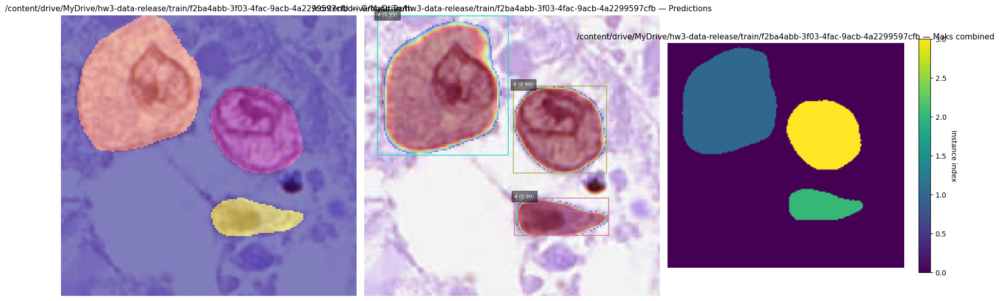

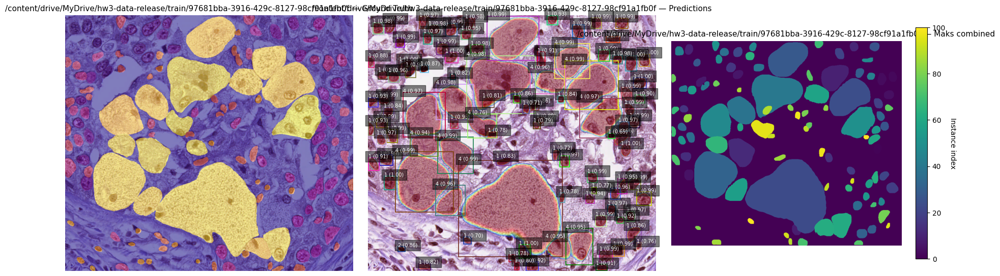

100%|██████████| 105/105 [03:30<00:00,  2.01s/it]


Epoch 6/10 | Train Loss: 0.4716
Best model saved (loss=0.4716)


100%|██████████| 105/105 [03:30<00:00,  2.01s/it]


Epoch 7/10 | Train Loss: 0.4706
Best model saved (loss=0.4706)


100%|██████████| 105/105 [03:30<00:00,  2.00s/it]


Epoch 8/10 | Train Loss: 0.4787


100%|██████████| 105/105 [03:24<00:00,  1.95s/it]


Epoch 9/10 | Train Loss: 0.4644
Best model saved (loss=0.4644)


100%|██████████| 105/105 [03:29<00:00,  1.99s/it]


Epoch 10/10 | Train Loss: 0.4568
Best model saved (loss=0.4568)


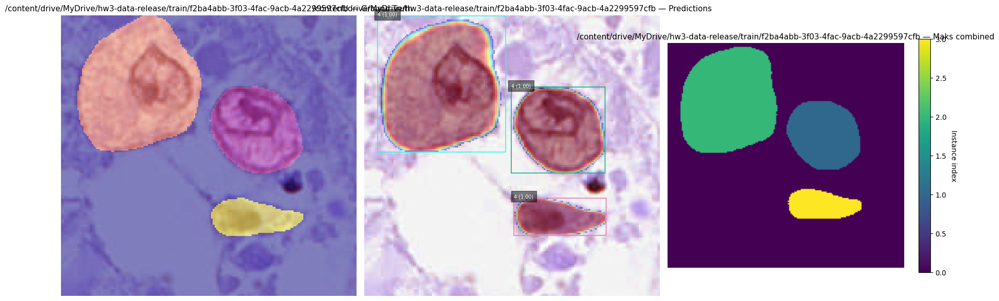

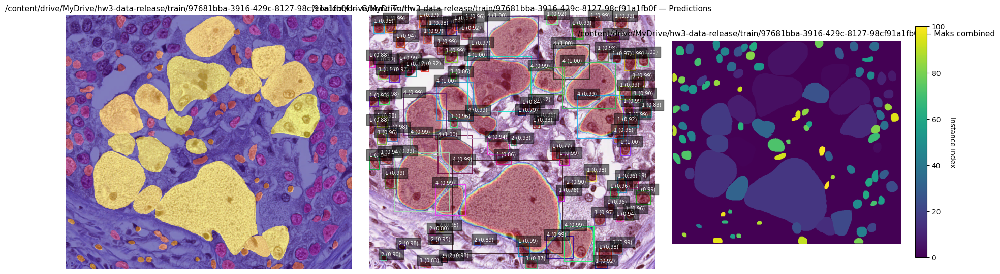

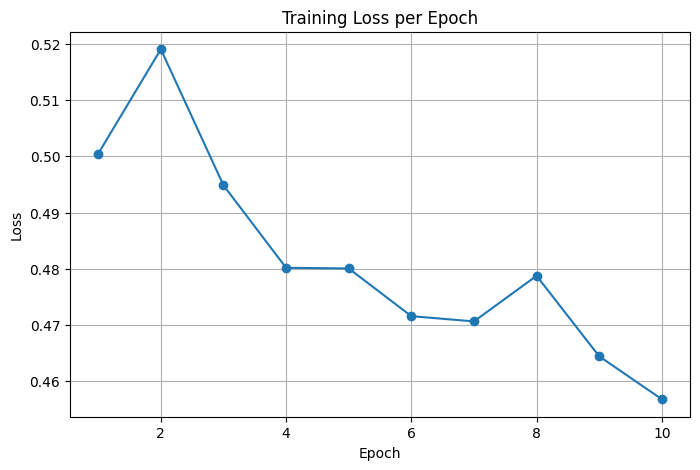

In [ ]:
#sans validation code simple resnet50
from tqdm import tqdm
from torch.optim.lr_scheduler import CosineAnnealingLR

num_epochs = 10
best_loss = float('inf')
train_losses = []
val_losses = []
optimizer = torch.optim.SGD(model.parameters(), lr=0.005, momentum=0.9, weight_decay=0.0005)
scheduler = CosineAnnealingLR(optimizer, T_max=num_epochs)

for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0

    for images, targets in tqdm(train_loader):
        images = [img.cuda() for img in images]
        targets = [{k: v.cuda() for k, v in t.items()} for t in targets]

        loss_dict = model(images, targets)
        losses = sum(loss for loss in loss_dict.values())

        optimizer.zero_grad()
        losses.backward()
        optimizer.step()

        running_loss += losses.item()
        #pbar.set_postfix(loss=losses.item())

    avg_loss = running_loss / len(train_loader)
    train_losses.append(avg_loss)

    # Evaluate on val
    #val_loss = evaluate_model(model, val_loader, device)
    #val_losses.append(val_loss)
    print(f"Epoch {epoch+1}/{num_epochs} | Train Loss: {avg_loss:.4f}")
    #print(f"Epoch {epoch+1}/{num_epochs} | Train Loss: {avg_loss:.4f} | Val Loss: {val_loss:.4f}")

    # 🔥 Enregistrement du meilleur modèle (si loss meilleure)
    if avg_loss < best_loss:
        best_loss = avg_loss
        torch.save(model.state_dict(), "/content/drive/MyDrive/best_model.pth")
        print(f"Best model saved (loss={best_loss:.4f})")

    if (epoch + 1) % 5 == 0:
        visualize_gt_vs_preds(model, val_loader, device, train_dataset)

# 📈 Courbe de loss
plt.figure(figsize=(8, 5))
plt.plot(range(1, num_epochs+1), train_losses, marker='o')
plt.title("Training Loss per Epoch")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.grid(True)
plt.show()

Distribution des class_id :
  Classe 1 : 2333 instances
  Classe 2 : 2649 instances
  Classe 3 : 415 instances
  Classe 4 : 499 instances


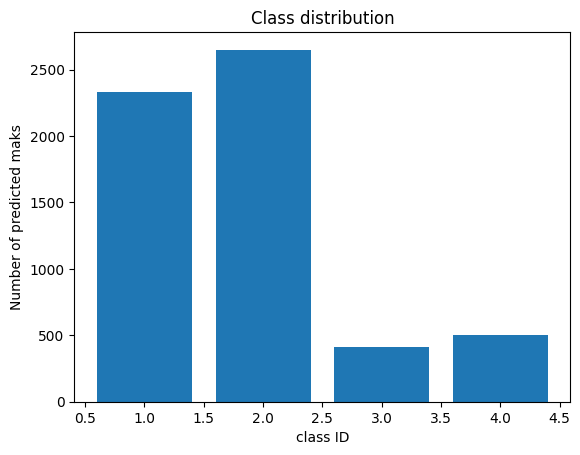

In [ ]:
import json
from collections import Counter
import matplotlib.pyplot as plt

# Load data
with open("test-results.json", "r") as f:
    results = json.load(f)

# EXtract category_id
category_ids = [r["category_id"] for r in results]

# Count
counter = Counter(category_ids)
print("Distribution des class_id :")
for k, v in sorted(counter.items()):
    print(f"  Classe {k} : {v} instances")

# bar chart plot
plt.bar(counter.keys(), counter.values())
plt.xlabel("class ID")
plt.ylabel("Number of predicted maks")
plt.title("Class distribution")
plt.show()


100%|██████████| 105/105 [03:23<00:00,  1.94s/it]


Epoch 1/10 | Train Loss: 0.9540 | Val Loss: 0.9041
✅ Best model saved (loss=0.9041)


100%|██████████| 105/105 [03:29<00:00,  1.99s/it]


Epoch 2/10 | Train Loss: 0.9017 | Val Loss: 0.8621
✅ Best model saved (loss=0.8621)


100%|██████████| 105/105 [03:28<00:00,  1.99s/it]


Epoch 3/10 | Train Loss: 0.8713 | Val Loss: 0.7787
✅ Best model saved (loss=0.7787)


100%|██████████| 105/105 [03:28<00:00,  1.98s/it]


Epoch 4/10 | Train Loss: 0.7923 | Val Loss: 0.7197
✅ Best model saved (loss=0.7197)


100%|██████████| 105/105 [03:28<00:00,  1.99s/it]


Epoch 5/10 | Train Loss: 0.7794 | Val Loss: 0.7241


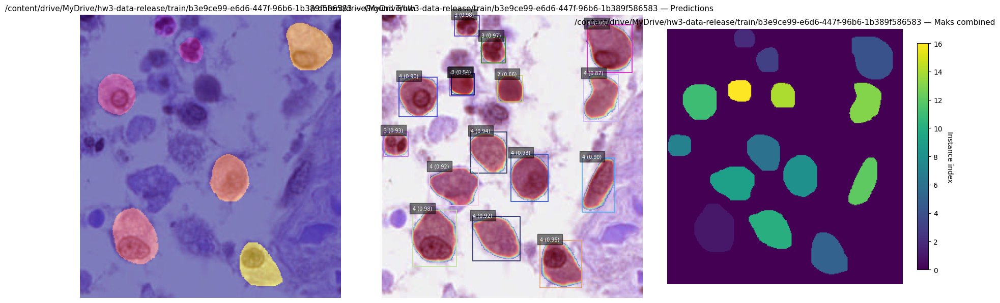

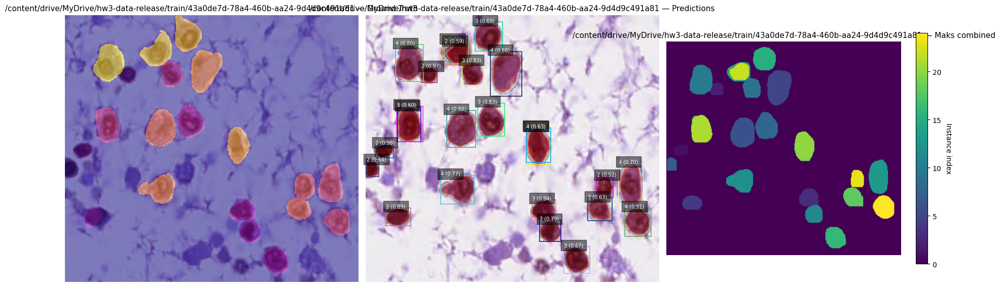

100%|██████████| 105/105 [03:25<00:00,  1.96s/it]


Epoch 6/10 | Train Loss: 0.7343 | Val Loss: 0.6858
✅ Best model saved (loss=0.6858)


100%|██████████| 105/105 [03:32<00:00,  2.02s/it]


Epoch 7/10 | Train Loss: 0.6999 | Val Loss: 0.6454
✅ Best model saved (loss=0.6454)


100%|██████████| 105/105 [03:27<00:00,  1.98s/it]


Epoch 8/10 | Train Loss: 0.6878 | Val Loss: 0.6837


100%|██████████| 105/105 [03:26<00:00,  1.96s/it]


Epoch 9/10 | Train Loss: 0.6478 | Val Loss: 0.5894
✅ Best model saved (loss=0.5894)


100%|██████████| 105/105 [03:27<00:00,  1.98s/it]


Epoch 10/10 | Train Loss: 0.6151 | Val Loss: 0.5974


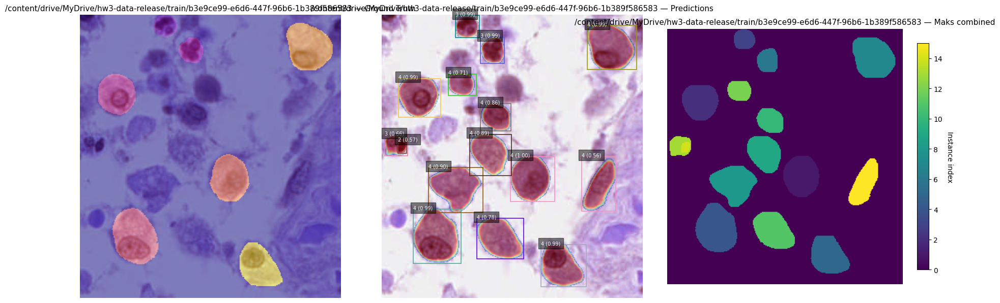

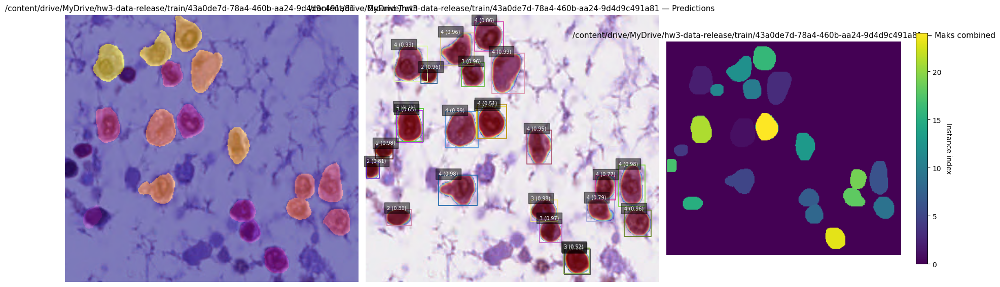

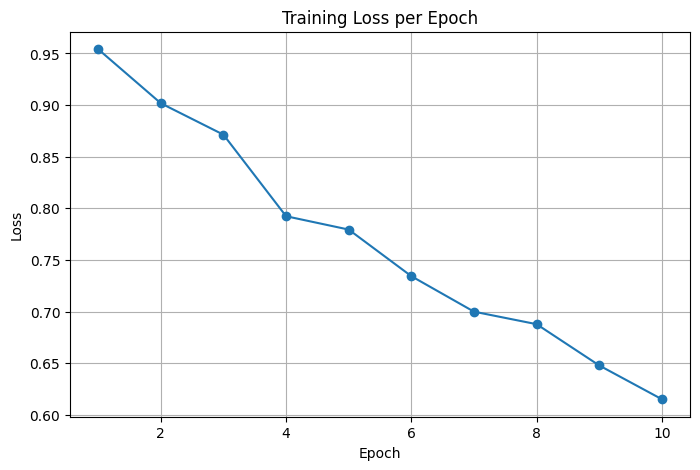

In [ ]:
#Same code with validation
from torch.optim.lr_scheduler import CosineAnnealingLR
from tqdm import tqdm

num_epochs = 10
best_loss = float('inf')
train_losses = []
val_losses = []
optimizer = torch.optim.SGD(model.parameters(), lr=0.005, momentum=0.9, weight_decay=0.0005)
scheduler = CosineAnnealingLR(optimizer, T_max=num_epochs)

for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0

    for images, targets in tqdm(train_loader):
        images = [img.cuda() for img in images]
        targets = [{k: v.cuda() for k, v in t.items()} for t in targets]

        loss_dict = model(images, targets)
        losses = sum(loss for loss in loss_dict.values())

        optimizer.zero_grad()
        losses.backward()
        optimizer.step()

        running_loss += losses.item()

    avg_loss = running_loss / len(train_loader)
    train_losses.append(avg_loss)

    # Evaluate on val
    val_loss = evaluate_model(model, val_loader, device)
    val_losses.append(val_loss)

    print(f"Epoch {epoch+1}/{num_epochs} | Train Loss: {avg_loss:.4f} | Val Loss: {val_loss:.4f}")

    # 🔥 Enregistrement du meilleur modèle (si loss meilleure)
    if val_loss < best_loss:
        best_loss = val_loss
        torch.save(model.state_dict(), "/content/drive/MyDrive/best_model.pth")
        print(f"Best model saved (loss={best_loss:.4f})")

    if (epoch + 1) % 5 == 0:
        visualize_gt_vs_preds(model, val_loader, device, train_dataset)

# 📈 Courbe de loss
plt.figure(figsize=(8, 5))
plt.plot(range(1, num_epochs+1), train_losses, marker='o')
plt.title("Training Loss per Epoch")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.grid(True)
plt.show()

Distribution des category_id :
  Classe 1 : 2533 instances
  Classe 2 : 2666 instances
  Classe 3 : 196 instances
  Classe 4 : 352 instances


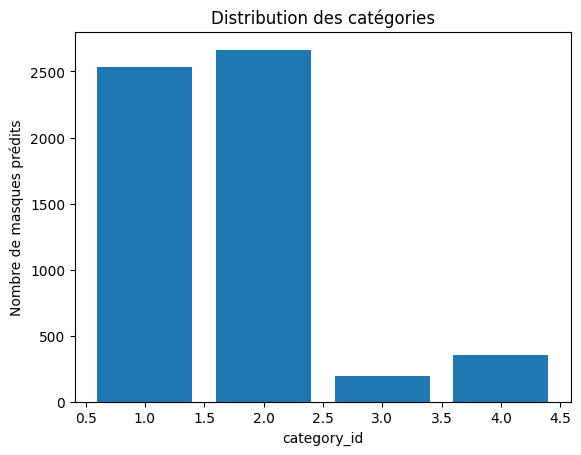

In [ ]:
import json
from collections import Counter
import matplotlib.pyplot as plt

# Load data
with open("test-results.json", "r") as f:
    results = json.load(f)

# EXtract category_id
category_ids = [r["category_id"] for r in results]

# Count
counter = Counter(category_ids)
print("Distribution des class_id :")
for k, v in sorted(counter.items()):
    print(f"  Classe {k} : {v} instances")

# bar chart plot
plt.bar(counter.keys(), counter.values())
plt.xlabel("class ID")
plt.ylabel("Number of predicted maks")
plt.title("Class distribution")
plt.show()


#Additional experiments

/usr/local/lib/python3.11/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
100%|██████████| 105/105 [20:15<00:00, 11.58s/it]


Epoch 1/10 | Train Loss: 1.6482
Best model saved (loss=1.6482)


100%|██████████| 105/105 [03:32<00:00,  2.02s/it]


Epoch 2/10 | Train Loss: 1.0878
Best model saved (loss=1.0878)


100%|██████████| 105/105 [03:33<00:00,  2.04s/it]


Epoch 3/10 | Train Loss: 0.9529
Best model saved (loss=0.9529)


100%|██████████| 105/105 [03:29<00:00,  1.99s/it]


Epoch 4/10 | Train Loss: 0.8706
Best model saved (loss=0.8706)


100%|██████████| 105/105 [03:35<00:00,  2.05s/it]


Epoch 5/10 | Train Loss: 0.8215
Best model saved (loss=0.8215)


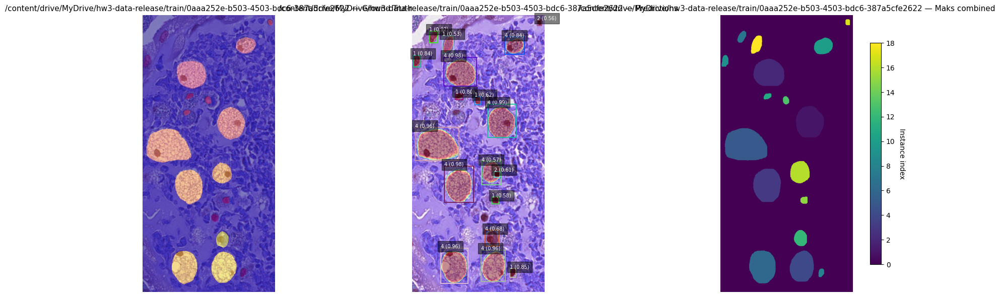

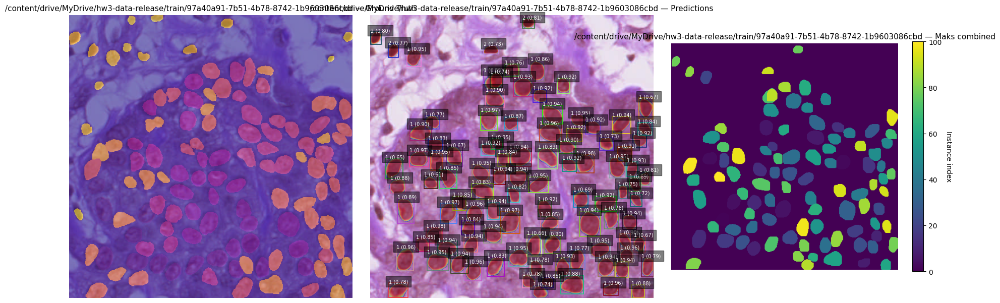

100%|██████████| 105/105 [03:33<00:00,  2.03s/it]


Epoch 6/10 | Train Loss: 0.7843
Best model saved (loss=0.7843)


100%|██████████| 105/105 [03:33<00:00,  2.03s/it]


Epoch 7/10 | Train Loss: 0.7394
Best model saved (loss=0.7394)


100%|██████████| 105/105 [03:33<00:00,  2.03s/it]


Epoch 8/10 | Train Loss: 0.6956
Best model saved (loss=0.6956)


100%|██████████| 105/105 [03:29<00:00,  2.00s/it]


Epoch 9/10 | Train Loss: 0.6920
Best model saved (loss=0.6920)


100%|██████████| 105/105 [03:30<00:00,  2.00s/it]


Epoch 10/10 | Train Loss: 0.6606
Best model saved (loss=0.6606)


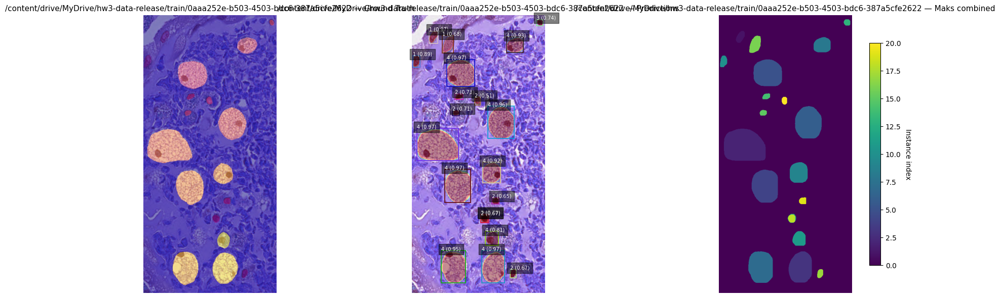

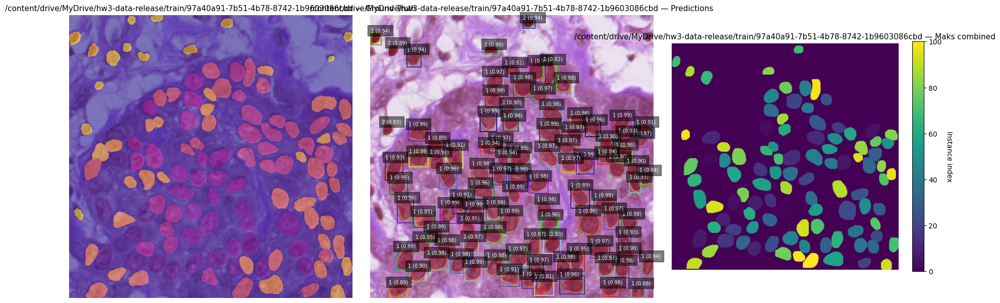

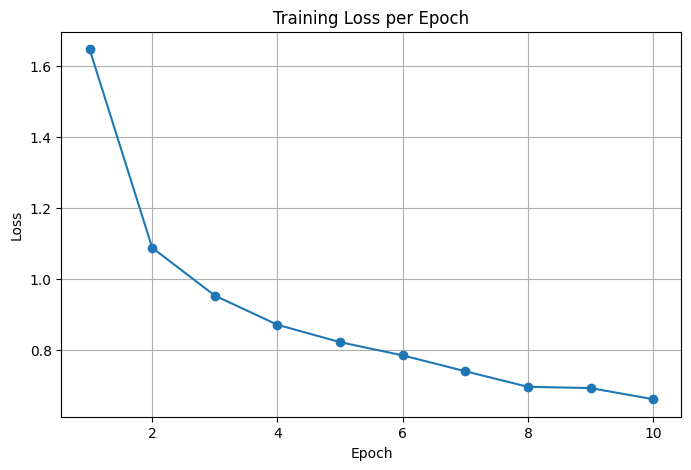

In [12]:
#experience 1: changing optimizer

from tqdm import tqdm
from torch.optim.lr_scheduler import CosineAnnealingLR
from torch.optim.lr_scheduler import ReduceLROnPlateau

num_epochs = 10
best_loss = float('inf')
train_losses = []
val_losses = []
optimizer = torch.optim.SGD(model.parameters(), lr=0.005, momentum=0.9, weight_decay=0.0005)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=2, verbose=True)

for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0

    for images, targets in tqdm(train_loader):
        images = [img.cuda() for img in images]
        targets = [{k: v.cuda() for k, v in t.items()} for t in targets]

        loss_dict = model(images, targets)
        losses = sum(loss for loss in loss_dict.values())

        optimizer.zero_grad()
        losses.backward()
        optimizer.step()

        running_loss += losses.item()
        #pbar.set_postfix(loss=losses.item())

    avg_loss = running_loss / len(train_loader)
    train_losses.append(avg_loss)

    # Evaluate on val
    #val_loss = evaluate_model(model, val_loader, device)
    #val_losses.append(val_loss)
    print(f"Epoch {epoch+1}/{num_epochs} | Train Loss: {avg_loss:.4f}")
    #print(f"Epoch {epoch+1}/{num_epochs} | Train Loss: {avg_loss:.4f} | Val Loss: {val_loss:.4f}")

    # 🔥 Enregistrement du meilleur modèle (si loss meilleure)
    if avg_loss < best_loss:
        best_loss = avg_loss
        torch.save(model.state_dict(), "/content/drive/MyDrive/best_model.pth")
        print(f"Best model saved (loss={best_loss:.4f})")

    if (epoch + 1) % 5 == 0:
        visualize_gt_vs_preds(model, val_loader, device, train_dataset)

# 📈 Courbe de loss
plt.figure(figsize=(8, 5))
plt.plot(range(1, num_epochs+1), train_losses, marker='o')
plt.title("Training Loss per Epoch")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.grid(True)
plt.show()

Distribution des class_id :
  Classe 1 : 2837 instances
  Classe 2 : 2469 instances
  Classe 3 : 499 instances
  Classe 4 : 273 instances


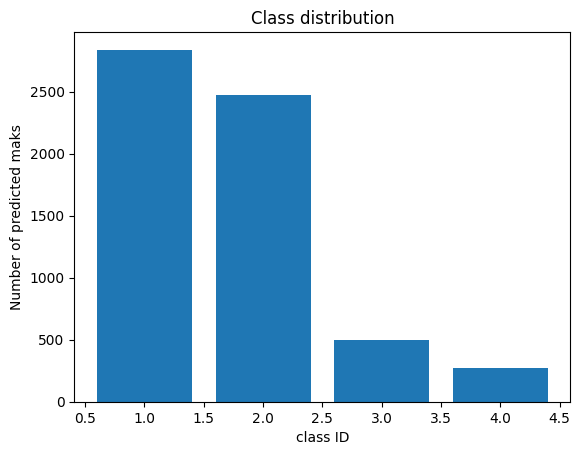

In [27]:
import json
from collections import Counter
import matplotlib.pyplot as plt

# Load data
with open("test-results.json", "r") as f:
    results = json.load(f)

# EXtract category_id
category_ids = [r["category_id"] for r in results]

# Count
counter = Counter(category_ids)
print("Distribution des class_id :")
for k, v in sorted(counter.items()):
    print(f"  Classe {k} : {v} instances")

# bar chart plot
plt.bar(counter.keys(), counter.values())
plt.xlabel("class ID")
plt.ylabel("Number of predicted maks")
plt.title("Class distribution")
plt.show()


#Experience 2: backbone = resnet101

In [28]:
#Experience 2 : backbone = resnet101
from torchvision.models.detection.backbone_utils import resnet_fpn_backbone
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision.models.detection.mask_rcnn import MaskRCNNPredictor
from torchvision.models.detection import MaskRCNN

def get_model_resnet101(num_classes):
    # Charger un Mask R-CNN avec backbone ResNet101 + FPN
    backbone = resnet_fpn_backbone('resnet101', pretrained=True)

    # Créer le modèle Mask R-CNN avec ce backbone
    model = MaskRCNN(backbone, num_classes=num_classes)

    # Remplacer la tête de classification (bbox)
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

    # Remplacer la tête de prédiction de masque
    in_features_mask = model.roi_heads.mask_predictor.conv5_mask.in_channels
    hidden_layer = 256
    model.roi_heads.mask_predictor = MaskRCNNPredictor(in_features_mask, hidden_layer, num_classes)

    return model

model = get_model_resnet101(num_classes=5)
model.cuda()


/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:135: UserWarning: Using 'backbone_name' as positional parameter(s) is deprecated since 0.13 and may be removed in the future. Please use keyword parameter(s) instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet101_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet101_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet101-63fe2227.pth" to /root/.cache/torch/hub/checkpoints/resnet101-

MaskRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=1e-05)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=1e-05)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=1e-05)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=1e-05)
          (relu):

/usr/local/lib/python3.11/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
100%|██████████| 105/105 [03:29<00:00,  2.00s/it]


Epoch 1/15 | Train Loss: 2.1984 | Val Loss: 1.9137
Best model saved (loss=1.9137)


100%|██████████| 105/105 [03:34<00:00,  2.05s/it]


Epoch 2/15 | Train Loss: 1.8069 | Val Loss: 1.7772
Best model saved (loss=1.7772)


100%|██████████| 105/105 [03:37<00:00,  2.07s/it]


Epoch 3/15 | Train Loss: 1.5862 | Val Loss: 1.4575
Best model saved (loss=1.4575)


100%|██████████| 105/105 [03:36<00:00,  2.07s/it]


Epoch 4/15 | Train Loss: 1.4481 | Val Loss: 1.3108
Best model saved (loss=1.3108)


100%|██████████| 105/105 [03:35<00:00,  2.05s/it]


Epoch 5/15 | Train Loss: 1.3209 | Val Loss: 1.2188
Best model saved (loss=1.2188)


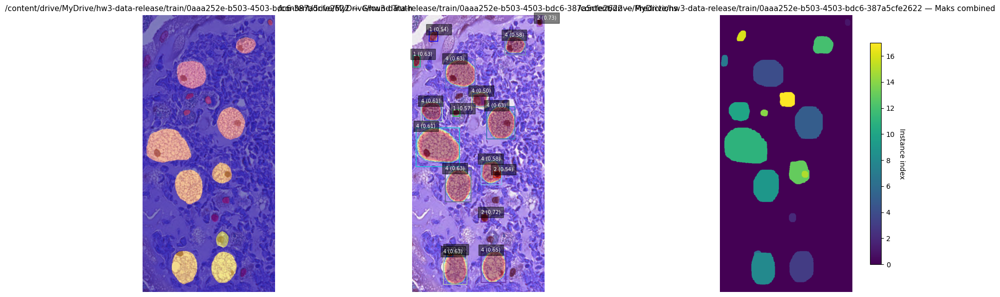

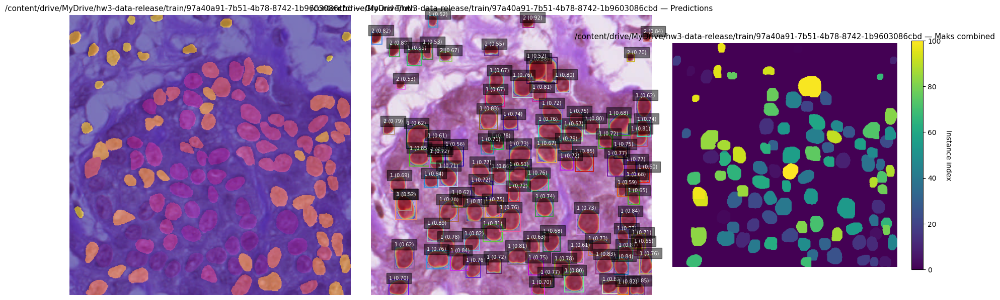

100%|██████████| 105/105 [03:38<00:00,  2.08s/it]


Epoch 6/15 | Train Loss: 1.2839 | Val Loss: 1.2122
Best model saved (loss=1.2122)


100%|██████████| 105/105 [03:39<00:00,  2.09s/it]


Epoch 7/15 | Train Loss: 1.1756 | Val Loss: 1.2355


100%|██████████| 105/105 [03:34<00:00,  2.04s/it]


Epoch 8/15 | Train Loss: 1.1377 | Val Loss: 1.1228
Best model saved (loss=1.1228)


100%|██████████| 105/105 [03:39<00:00,  2.09s/it]


Epoch 9/15 | Train Loss: 1.0997 | Val Loss: 1.0281
Best model saved (loss=1.0281)


100%|██████████| 105/105 [03:37<00:00,  2.08s/it]


Epoch 10/15 | Train Loss: 1.0525 | Val Loss: 1.0537


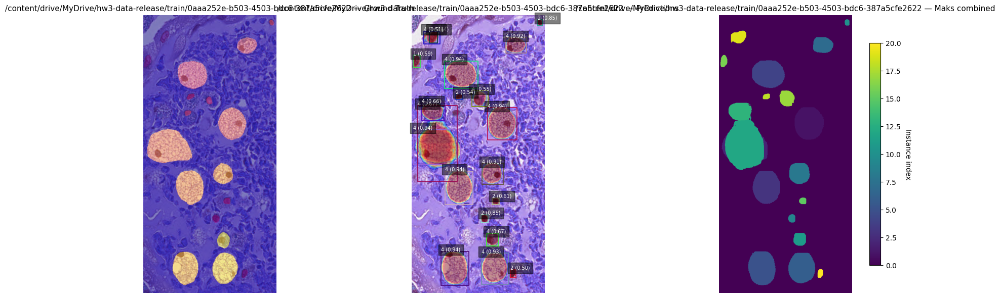

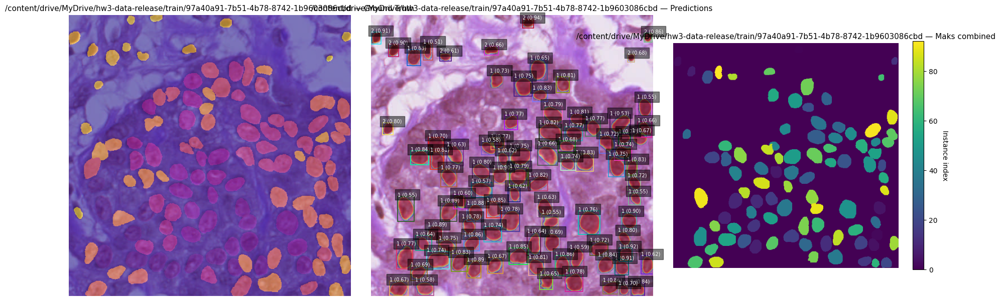

100%|██████████| 105/105 [03:36<00:00,  2.06s/it]


Epoch 11/15 | Train Loss: 0.9953 | Val Loss: 0.9480
Best model saved (loss=0.9480)


100%|██████████| 105/105 [03:40<00:00,  2.10s/it]


Epoch 12/15 | Train Loss: 0.9572 | Val Loss: 0.9298
Best model saved (loss=0.9298)


100%|██████████| 105/105 [03:40<00:00,  2.10s/it]


Epoch 13/15 | Train Loss: 0.9143 | Val Loss: 0.9677


100%|██████████| 105/105 [03:35<00:00,  2.05s/it]


Epoch 14/15 | Train Loss: 0.9340 | Val Loss: 0.8774
Best model saved (loss=0.8774)


100%|██████████| 105/105 [03:40<00:00,  2.10s/it]


Epoch 15/15 | Train Loss: 0.8631 | Val Loss: 0.8340
Best model saved (loss=0.8340)


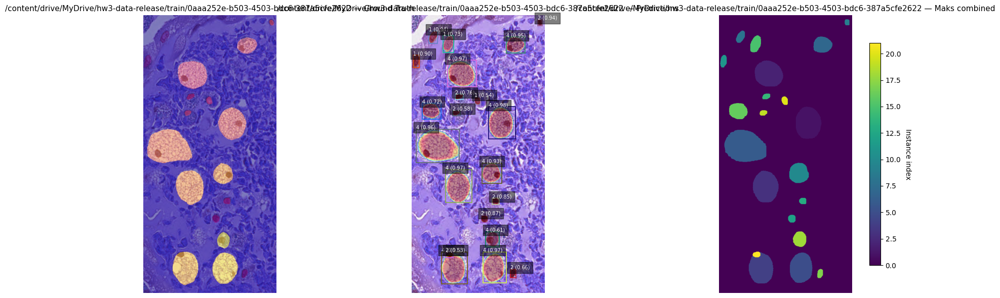

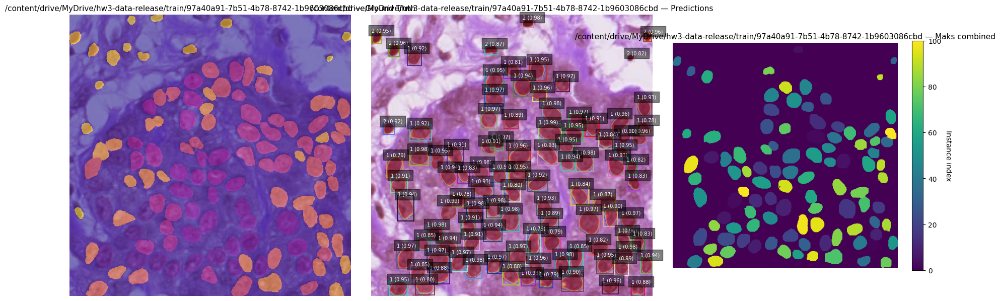

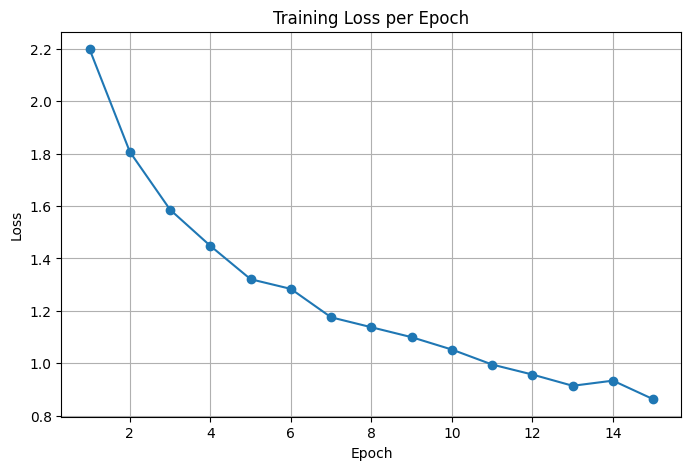

In [29]:
from tqdm import tqdm
from torch.optim.lr_scheduler import CosineAnnealingLR

num_epochs = 15
best_loss = float('inf')
train_losses = []
val_losses = []

optimizer = torch.optim.SGD(model.parameters(), lr=0.005, momentum=0.9, weight_decay=0.0005)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=2, verbose=True)

for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0

    for images, targets in tqdm(train_loader):
        images = [img.cuda() for img in images]
        targets = [{k: v.cuda() for k, v in t.items()} for t in targets]

        loss_dict = model(images, targets)
        losses = sum(loss for loss in loss_dict.values())

        optimizer.zero_grad()
        losses.backward()
        optimizer.step()

        running_loss += losses.item()
        #pbar.set_postfix(loss=losses.item())

    avg_loss = running_loss / len(train_loader)
    train_losses.append(avg_loss)

    # Evaluate on val
    val_loss = evaluate_model(model, val_loader, device)
    val_losses.append(val_loss)
    print(f"Epoch {epoch+1}/{num_epochs} | Train Loss: {avg_loss:.4f} | Val Loss: {val_loss:.4f}")

    # 🔥 Enregistrement du meilleur modèle (si loss meilleure)
    if val_loss < best_loss:
        best_loss = val_loss
        torch.save(model.state_dict(), "/content/drive/MyDrive/best_model.pth")
        print(f"Best model saved (loss={best_loss:.4f})")

    if (epoch + 1) % 5 == 0:
        visualize_gt_vs_preds(model, val_loader, device, train_dataset)

# 📈 Courbe de loss
plt.figure(figsize=(8, 5))
plt.plot(range(1, num_epochs+1), train_losses, marker='o')
plt.title("Training Loss per Epoch")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.grid(True)
plt.show()

Distribution des class_id :
  Classe 1 : 2562 instances
  Classe 2 : 2909 instances
  Classe 3 : 371 instances
  Classe 4 : 331 instances


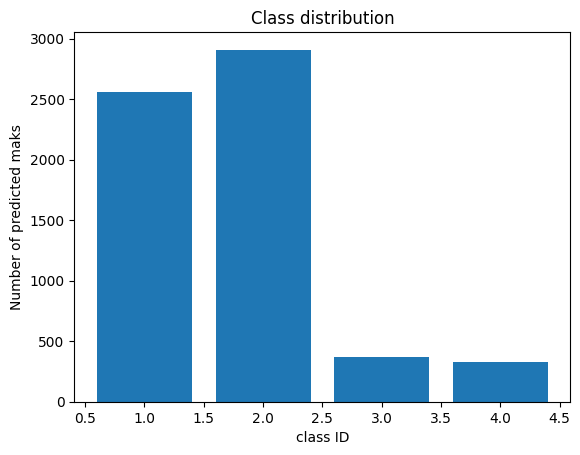

In [32]:
import json
from collections import Counter
import matplotlib.pyplot as plt

# Load data
with open("test-results.json", "r") as f:
    results = json.load(f)

# EXtract category_id
category_ids = [r["category_id"] for r in results]

# Count
counter = Counter(category_ids)
print("Distribution des class_id :")
for k, v in sorted(counter.items()):
    print(f"  Classe {k} : {v} instances")

# bar chart plot
plt.bar(counter.keys(), counter.values())
plt.xlabel("class ID")
plt.ylabel("Number of predicted maks")
plt.title("Class distribution")
plt.show()


#Experience 3: adding transform


In [ ]:
import torchvision.transforms.functional as TF
import random

class SimpleTransformTorch:
    def __init__(self):
        pass  # Pas de paramètre pour l’instant

    def __call__(self, image, target):
        # Récupérer les masques de la target
        masks = target["masks"]

        # Flip horizontal
        if random.random() > 0.5:
            image = TF.hflip(image)
            masks = TF.hflip(masks)
            # Adapter les boxes
            width = image.shape[2]
            boxes = target["boxes"]
            boxes[:, [0, 2]] = width - boxes[:, [2, 0]]
            target["boxes"] = boxes

        # Flip vertical
        if random.random() > 0.5:
            image = TF.vflip(image)
            masks = TF.vflip(masks)
            # Adapter les boxes
            height = image.shape[1]
            boxes = target["boxes"]
            boxes[:, [1, 3]] = height - boxes[:, [3, 1]]
            target["boxes"] = boxes

        target["masks"] = masks
        return image, target

100%|██████████| 105/105 [03:22<00:00,  1.93s/it]


Epoch 1/10 | Train Loss: 1.7844 | Val Loss: 1.1563
Best model saved (loss=1.1563)


100%|██████████| 105/105 [03:26<00:00,  1.96s/it]


Epoch 2/10 | Train Loss: 1.1658 | Val Loss: 0.9816
Best model saved (loss=0.9816)


100%|██████████| 105/105 [03:27<00:00,  1.97s/it]


Epoch 3/10 | Train Loss: 1.0179 | Val Loss: 0.9387
Best model saved (loss=0.9387)


100%|██████████| 105/105 [03:27<00:00,  1.98s/it]


Epoch 4/10 | Train Loss: 0.9154 | Val Loss: 0.8670
Best model saved (loss=0.8670)


100%|██████████| 105/105 [03:27<00:00,  1.98s/it]


Epoch 5/10 | Train Loss: 0.8832 | Val Loss: 0.8163
Best model saved (loss=0.8163)


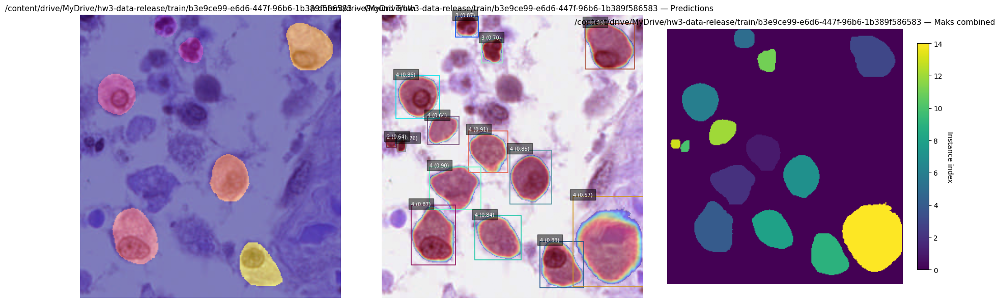

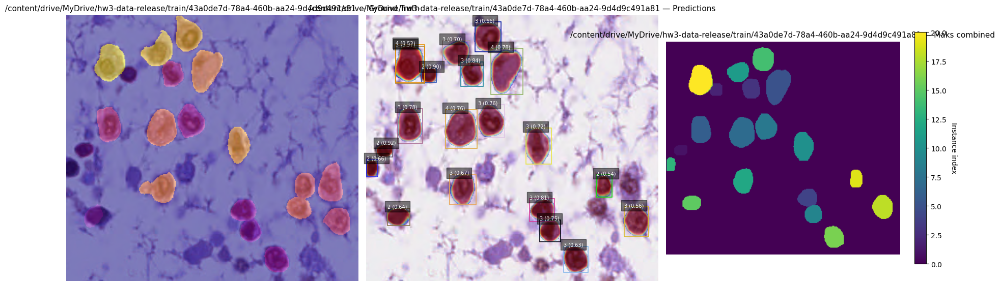

100%|██████████| 105/105 [03:27<00:00,  1.97s/it]


Epoch 6/10 | Train Loss: 0.8178 | Val Loss: 0.7427
Best model saved (loss=0.7427)


100%|██████████| 105/105 [03:24<00:00,  1.95s/it]


Epoch 7/10 | Train Loss: 0.7711 | Val Loss: 0.7333
Best model saved (loss=0.7333)


100%|██████████| 105/105 [03:26<00:00,  1.97s/it]


Epoch 8/10 | Train Loss: 0.7333 | Val Loss: 0.6542
Best model saved (loss=0.6542)


100%|██████████| 105/105 [03:25<00:00,  1.96s/it]


Epoch 9/10 | Train Loss: 0.6981 | Val Loss: 0.7429


100%|██████████| 105/105 [03:23<00:00,  1.94s/it]


Epoch 10/10 | Train Loss: 0.7133 | Val Loss: 0.6074
Best model saved (loss=0.6074)


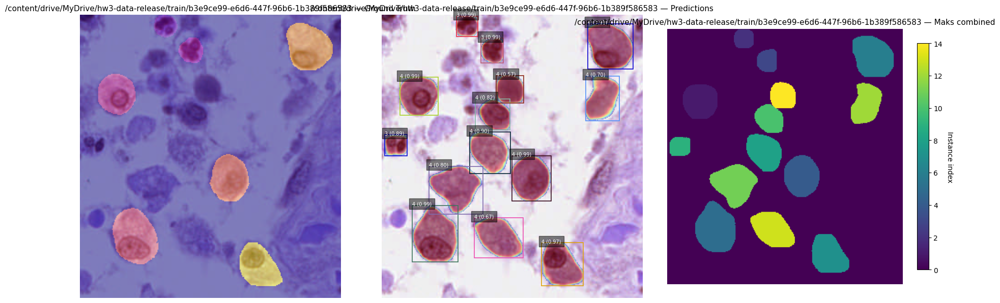

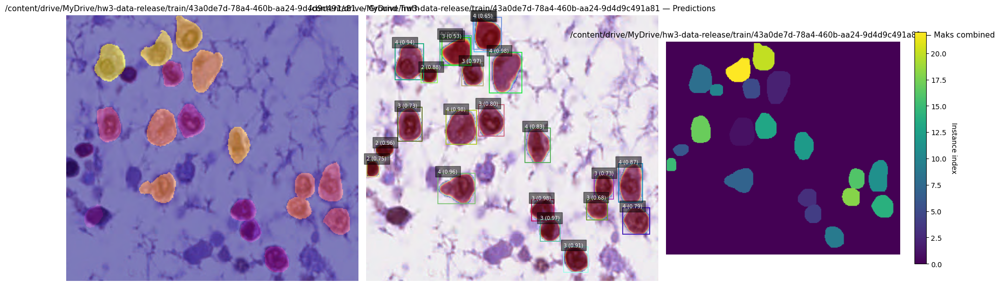

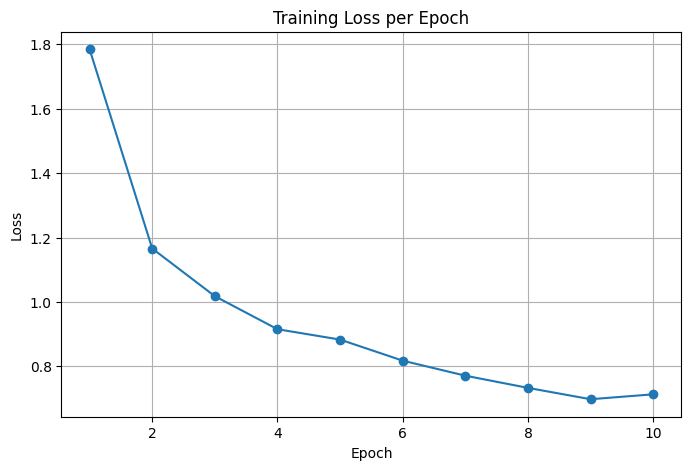

In [ ]:
dataset = CustomInstanceDataset('/content/drive/MyDrive/hw3-data-release/train', transforms=SimpleTransformTorch())

num_epochs = 10
best_loss = float('inf')
train_losses = []
val_losses = []
optimizer = torch.optim.SGD(model.parameters(), lr=0.005, momentum=0.9, weight_decay=0.0005)
scheduler = CosineAnnealingLR(optimizer, T_max=num_epochs)

for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0

    for images, targets in tqdm(train_loader):
        images = [img.cuda() for img in images]
        targets = [{k: v.cuda() for k, v in t.items()} for t in targets]

        loss_dict = model(images, targets)
        losses = sum(loss for loss in loss_dict.values())

        optimizer.zero_grad()
        losses.backward()
        optimizer.step()

        running_loss += losses.item()
        #pbar.set_postfix(loss=losses.item())

    avg_loss = running_loss / len(train_loader)
    train_losses.append(avg_loss)

    # Evaluate on val
    val_loss = evaluate_model(model, val_loader, device)
    val_losses.append(val_loss)

    print(f"Epoch {epoch+1}/{num_epochs} | Train Loss: {avg_loss:.4f} | Val Loss: {val_loss:.4f}")

    # 🔥 Enregistrement du meilleur modèle (si loss meilleure)
    if val_loss < best_loss:
        best_loss = val_loss
        torch.save(model.state_dict(), "/content/drive/MyDrive/best_model.pth")
        print(f"Best model saved (loss={best_loss:.4f})")

    if (epoch + 1) % 5 == 0:
        visualize_gt_vs_preds(model, val_loader, device, train_dataset)

# 📈 Courbe de loss
plt.figure(figsize=(8, 5))
plt.plot(range(1, num_epochs+1), train_losses, marker='o')
plt.title("Training Loss per Epoch")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.grid(True)
plt.show()

Distribution des class_id :
  Classe 1 : 2333 instances
  Classe 2 : 2649 instances
  Classe 3 : 415 instances
  Classe 4 : 499 instances


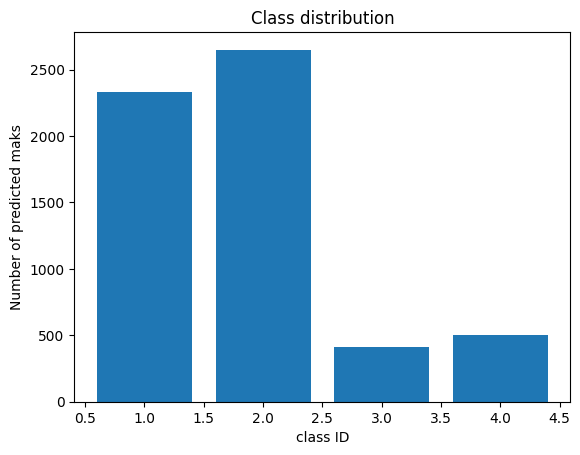

In [ ]:
import json
from collections import Counter
import matplotlib.pyplot as plt

# Load data
with open("test-results.json", "r") as f:
    results = json.load(f)

# EXtract category_id
category_ids = [r["category_id"] for r in results]

# Count
counter = Counter(category_ids)
print("Distribution des class_id :")
for k, v in sorted(counter.items()):
    print(f"  Classe {k} : {v} instances")

# bar chart plot
plt.bar(counter.keys(), counter.values())
plt.xlabel("class ID")
plt.ylabel("Number of predicted maks")
plt.title("Class distribution")
plt.show()


#TEST

In [30]:
from utils import encode_mask
import matplotlib.pyplot as plt

model.eval()
submission = []

with open('/content/drive/MyDrive/hw3-data-release/test_image_name_to_ids.json') as f:
    raw_list = json.load(f)
    name2id = {entry["file_name"]: entry["id"] for entry in raw_list}

test_dir = Path('/content/drive/MyDrive/hw3-data-release/test_release')
test_paths = list(test_dir.glob("*.tif"))

print(f"Total test images found: {len(test_paths)}")

for img_path in tqdm(test_paths):
    # Load image
    image = cv2.imread(str(img_path))
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    image_tensor = torch.as_tensor(image / 255.0, dtype=torch.float32).permute(2, 0, 1).unsqueeze(0).cuda()

    # Run inference
    with torch.no_grad():
        preds = model(image_tensor)[0]

    image_id = name2id[img_path.name]
    num_preds = len(preds["masks"])
    print(f"\n[{img_path.name}] have {num_preds} predictions")

    for i, (mask, label, score) in enumerate(zip(preds["masks"], preds["labels"], preds["scores"])):
        score = float(score.item())

        #if score low then ignore
        if score < 0.3:
            continue

        binary_mask = mask[0].cpu().numpy() > 0.5
        rle = encode_mask(binary_mask)

        submission.append({
            "image_id": image_id,
            "category_id": int(label),
            "segmentation": rle,
            "score": score
        })

# Save results
with open("test-results.json", "w") as f:
    json.dump(submission, f)
print(f"\nSubmission file saved with {len(submission)} instances → test-results.json")


Total test images found: 101


  0%|          | 0/101 [00:00<?, ?it/s]


[07517165-7bd5-4a30-8433-3c8830358bc0.tif] have 100 predictions


  2%|▏         | 2/101 [00:01<00:54,  1.81it/s]


[02e1b69a-2441-4e23-a61e-4b36617efd06.tif] have 50 predictions

[20095851-78c0-4c77-8ef7-87d27ca78746.tif] have 100 predictions


  4%|▍         | 4/101 [00:01<00:29,  3.24it/s]


[1d7c79b9-922c-478d-a942-b6724dae81dc.tif] have 31 predictions

[1dc79238-44b9-4274-bedd-5955019b1364.tif] have 100 predictions


  5%|▍         | 5/101 [00:02<00:51,  1.86it/s]


[24f246b8-e442-4312-8088-c6ed2eabeaf6.tif] have 100 predictions


  8%|▊         | 8/101 [00:03<00:33,  2.74it/s]


[06efce1e-bec6-4314-a308-a76815507c6d.tif] have 6 predictions

[15bd2c22-962f-4509-82a5-c4d9488cd7a0.tif] have 73 predictions

[1059cdc7-e5cf-4c32-9e26-2c7770997301.tif] have 100 predictions


 10%|▉         | 10/101 [00:04<00:34,  2.63it/s]


[01ce9840-ea96-495e-8fd1-696a734956af.tif] have 100 predictions


 12%|█▏        | 12/101 [00:04<00:22,  3.88it/s]


[0bd26f8e-81f6-4267-82ad-740e2786393a.tif] have 33 predictions

[0fb9d9c0-f786-49c5-b485-b8dfdcce929c.tif] have 100 predictions


 13%|█▎        | 13/101 [00:04<00:21,  4.06it/s]


[29ea4123-e8a5-4c65-937e-945222beb9f2.tif] have 100 predictions


 14%|█▍        | 14/101 [00:05<00:19,  4.37it/s]


[1950b786-e805-462c-82b8-cf7667912720.tif] have 100 predictions

[14792cd4-ce7e-44fa-a63b-9e5663e2f479.tif] have 45 predictions

[2746000b-78bc-42f5-9c77-91bd5d012b9f.tif] have 100 predictions


 17%|█▋        | 17/101 [00:06<00:26,  3.18it/s]


[009510f3-2d1a-435e-b733-90f5450baaca.tif] have 100 predictions


 18%|█▊        | 18/101 [00:06<00:21,  3.82it/s]


[85f0cf1c-6ea7-42c6-a15d-a89a6064f534.tif] have 58 predictions

[bd0655c8-87c8-44f4-98b1-1d65090f1708.tif] have 7 predictions

[c8cb7626-7423-4c1e-a81c-5ff25ea180b3.tif] have 100 predictions


 21%|██        | 21/101 [00:06<00:15,  5.21it/s]


[c2d97d5d-bfe4-4448-b2f4-2eb8951fdf92.tif] have 100 predictions

[3c4bc1a8-9ecc-4e3f-bbbf-5ec6bcd2cf80.tif] have 100 predictions


 23%|██▎       | 23/101 [00:07<00:17,  4.50it/s]


[804d0559-fcb2-405f-97d9-d56649944cc5.tif] have 100 predictions


 24%|██▍       | 24/101 [00:07<00:18,  4.21it/s]


[939b1048-3a4a-4b09-afb8-7fb0557ff017.tif] have 100 predictions

[a7471984-0dc5-4a99-bb28-3b294000cebf.tif] have 15 predictions

[af70e728-27c2-4fc7-96f0-a29261f0f1b0.tif] have 100 predictions


 29%|██▊       | 29/101 [00:08<00:10,  6.60it/s]


[be8f6ce1-954b-4010-9582-e1ea131bbd14.tif] have 34 predictions

[8bf17017-577c-4bc7-b599-df8289a69279.tif] have 30 predictions

[acaf16a8-d1e6-4746-92ae-c76fa82cb70d.tif] have 54 predictions

[d09497c6-0515-4838-b7bc-95a6a8bdd969.tif] have 100 predictions


 32%|███▏      | 32/101 [00:09<00:15,  4.35it/s]


[940ddc4b-d03a-42e2-ac0a-45ac5bb9f52a.tif] have 30 predictions

[8b89f5d4-f18f-45da-b0de-9312ac2bae43.tif] have 24 predictions


 34%|███▎      | 34/101 [00:09<00:12,  5.16it/s]


[e5244dee-5760-4f73-a7eb-1589cef56dc9.tif] have 42 predictions

[46d00689-6a3e-479b-a212-ebfa75b4c885.tif] have 100 predictions

[b9409c11-9c04-412c-82d2-4bc92b1e8090.tif] have 39 predictions

[4e55bbd2-dd32-4781-8625-e5e8d0a75244.tif] have 100 predictions


 38%|███▊      | 38/101 [00:10<00:12,  5.22it/s]


[7ba7d862-ef2c-4887-99d1-298bad5ef6f6.tif] have 100 predictions

[d2593051-b214-484f-b23a-175523c41b66.tif] have 55 predictions


 39%|███▊      | 39/101 [00:10<00:11,  5.31it/s]


[68e0853d-bc17-4ac1-b40f-56dd5105d1e4.tif] have 100 predictions

[c621555b-a04b-4c5e-9eeb-d66e7e1c754c.tif] have 32 predictions


 41%|████      | 41/101 [00:10<00:10,  5.68it/s]


[e9813521-149f-4cc4-bec5-b96fc1d0f79b.tif] have 100 predictions


 42%|████▏     | 42/101 [00:11<00:09,  6.05it/s]


[6197235b-d09c-4893-82fc-1fbb8304fb5a.tif] have 17 predictions

[4b7ae742-03c2-4c4a-9a9d-0cf5c389a07d.tif] have 100 predictions


 44%|████▎     | 44/101 [00:11<00:12,  4.74it/s]


[7c1dc236-ebfd-4a5d-b292-286b9e54b1e8.tif] have 10 predictions

[2cd8f294-b513-40e9-9d41-7e42670ffbe5.tif] have 30 predictions


 46%|████▌     | 46/101 [00:11<00:10,  5.00it/s]


[731d66e7-79fd-4b5a-a77d-c3fefacc6bd3.tif] have 100 predictions


 47%|████▋     | 47/101 [00:12<00:10,  5.33it/s]


[68088187-8f8d-476c-bfad-ad8d33b0ef36.tif] have 47 predictions

[e8387c52-e443-42c4-b61c-12e91f9d4ed2.tif] have 100 predictions


 50%|████▉     | 50/101 [00:12<00:07,  6.78it/s]


[64ad745d-62c0-4a40-ac03-07f4946753b7.tif] have 21 predictions

[b8286317-5279-48c4-bb5b-be8947d67c47.tif] have 7 predictions

[58b58086-b220-44da-bf60-c977162b6b08.tif] have 100 predictions


 51%|█████▏    | 52/101 [00:13<00:16,  3.00it/s]


[89fce9d5-33b8-4ae9-ae63-5ee43e99938f.tif] have 100 predictions


 52%|█████▏    | 53/101 [00:14<00:15,  3.16it/s]


[64321b99-230b-437c-a005-28671ff2d30c.tif] have 100 predictions


 53%|█████▎    | 54/101 [00:14<00:12,  3.69it/s]


[51afba30-76b9-4c08-9378-ec39a3517e19.tif] have 97 predictions

[eaccffed-97b8-4103-9db0-3e319c6a1d3b.tif] have 100 predictions


 55%|█████▌    | 56/101 [00:14<00:12,  3.74it/s]


[93c3640a-7b5a-419c-9418-f53c670fa46f.tif] have 100 predictions


 56%|█████▋    | 57/101 [00:15<00:12,  3.54it/s]


[9a0001c6-450f-44e3-a80a-fd69544c425e.tif] have 100 predictions


 58%|█████▊    | 59/101 [00:15<00:08,  4.93it/s]


[4c9af251-033a-44fb-ab13-e37b363c7d7a.tif] have 43 predictions

[de044f20-3d06-42b2-846b-d39ab1eddadd.tif] have 11 predictions


 59%|█████▉    | 60/101 [00:15<00:08,  4.60it/s]


[e9660304-f3cb-4b93-bdf1-745653388f9e.tif] have 100 predictions


 61%|██████▏   | 62/101 [00:15<00:07,  5.38it/s]


[e97728a0-b44d-474e-9462-0e4d02ee75e3.tif] have 46 predictions

[ddd220f2-e7d4-4765-9564-f0abd1f7e8f3.tif] have 11 predictions

[d905c217-89d3-48b8-ae4d-a9d1b66f2e53.tif] have 100 predictions


 63%|██████▎   | 64/101 [00:16<00:08,  4.44it/s]


[de44c654-fef8-46a6-bbbc-89fa473cd78c.tif] have 99 predictions

[e685433a-69bf-46a2-b87b-ea44b592a947.tif] have 100 predictions


 64%|██████▍   | 65/101 [00:16<00:10,  3.38it/s]


[588dc5c8-4a99-4c47-9f80-8597ef6e4044.tif] have 13 predictions

[d1289bd6-5115-4c7b-a2fe-d0312f2f209a.tif] have 100 predictions


 66%|██████▋   | 67/101 [00:17<00:07,  4.28it/s]


[2f726f76-53d5-4b55-b2f8-96d9ea916c8b.tif] have 100 predictions


 68%|██████▊   | 69/101 [00:17<00:07,  4.15it/s]


[af562712-ee2f-49e0-9965-73fdf4fb1078.tif] have 76 predictions

[646cfbd8-d39b-49b5-b5f6-72da8d760715.tif] have 5 predictions


 70%|███████   | 71/101 [00:18<00:05,  5.49it/s]


[81cd3f07-db07-4638-ad49-2a6d240d7594.tif] have 100 predictions

[7b025851-a03c-4d39-a34f-bf441ea7a381.tif] have 32 predictions


 72%|███████▏  | 73/101 [00:18<00:05,  5.40it/s]


[c6febe12-5a64-4487-9455-c554f69087c7.tif] have 100 predictions

[4050223c-596c-4dd4-b99d-e0142b9969c8.tif] have 26 predictions


 74%|███████▍  | 75/101 [00:18<00:04,  5.46it/s]


[39889486-0933-4fc4-bfef-13621fd99d52.tif] have 100 predictions


 75%|███████▌  | 76/101 [00:19<00:05,  4.74it/s]


[e476dbc8-ad34-4116-a330-3a6b5b943a26.tif] have 100 predictions

[eb3b21ea-5906-42d8-9903-6b18408a1964.tif] have 17 predictions

[7d6f1f3e-53f5-4413-9a15-63a04fed6434.tif] have 100 predictions


 79%|███████▉  | 80/101 [00:19<00:04,  4.99it/s]


[bd0cc05f-33b8-41ed-b68e-9d7719e440d3.tif] have 100 predictions

[5e7ad04b-b06e-4198-a063-733e7824fddf.tif] have 90 predictions


 80%|████████  | 81/101 [00:20<00:04,  4.64it/s]


[e5b609b7-fba5-4a45-8a10-57ebf8110ef7.tif] have 100 predictions


 81%|████████  | 82/101 [00:20<00:03,  5.31it/s]


[e884983b-e773-405b-87b8-3c47a4d57322.tif] have 42 predictions

[b270d133-be95-41bd-b336-bc5b1a1e33c8.tif] have 100 predictions


 84%|████████▍ | 85/101 [00:21<00:03,  4.72it/s]


[774ee917-db30-4503-85bc-2ca51760a999.tif] have 79 predictions

[8b86a9f0-9982-43a5-a59c-7d1848759de8.tif] have 100 predictions


 85%|████████▌ | 86/101 [00:21<00:03,  4.52it/s]


[c911338d-ec00-46d3-a9bc-9953d0d5bdc9.tif] have 100 predictions

[4ec7ceb0-3995-49ee-81ed-acc5e48cf4bb.tif] have 38 predictions


 87%|████████▋ | 88/101 [00:21<00:02,  5.81it/s]


[41f145de-42b1-4bb8-9825-e6a002a9ee40.tif] have 29 predictions

[8e1465e1-2870-471f-b5a7-501bf564f815.tif] have 20 predictions


 89%|████████▉ | 90/101 [00:21<00:01,  5.97it/s]


[79777953-3c78-4393-b6a8-076f47ef4188.tif] have 100 predictions

[361ae396-de1f-43c4-865d-01e45d02250a.tif] have 42 predictions


 91%|█████████ | 92/101 [00:22<00:01,  5.60it/s]


[76b11ec0-965a-4cf2-9f12-f445fc10a827.tif] have 100 predictions


 92%|█████████▏| 93/101 [00:22<00:01,  5.76it/s]


[f1911811-ac44-411f-8d74-2a0f7650093c.tif] have 100 predictions

[f33b6912-c123-4266-a353-bf61d2f6fb40.tif] have 23 predictions


 94%|█████████▍| 95/101 [00:22<00:01,  5.73it/s]


[ff6ba8cf-a6f7-4086-b537-c2fb97eae1da.tif] have 100 predictions

[eca9ee95-e636-4f96-9f60-c5d751750433.tif] have 100 predictions


 96%|█████████▌| 97/101 [00:23<00:01,  3.60it/s]


[f40a9897-cd22-488e-b8c9-51f860e0ba99.tif] have 100 predictions


 97%|█████████▋| 98/101 [00:23<00:00,  3.64it/s]


[f9c8d622-4587-46e8-a67f-500972010caf.tif] have 100 predictions


 98%|█████████▊| 99/101 [00:24<00:00,  3.66it/s]


[eeabdd69-c853-4327-8ede-844c336468b6.tif] have 100 predictions

[eeeec04d-869a-4ed0-96ab-19ef8ed48cca.tif] have 42 predictions

[eeb1d7bb-e1d5-4198-ad47-edd99af374ce.tif] have 100 predictions


100%|██████████| 101/101 [00:25<00:00,  4.02it/s]


Submission file saved with 6173 instances → test-results.json
